# Week 8 - Semantic Networks

This week, we explore the representation and analysis of semantic networks. A word or document network is an unsupervized representation of text akin to a clustering or an embedding, but semantic networks can also be defined using semantic or syntactic information derived from methods we have used earlier in the quarter. For example, we can define links between words as a function of their co-presence within a document, chapter, paragraph, sentence, noun phrase or continuous bag of words. We can also define links as a function of words that rely on one another within a directed dependency parse, or links between extracted Subjects, Verbs and Objects, or nouns and the adjectives that modify them (or verbs and the adverbs that modify *them*). Rendering words linked as a network or discrete topology allows us to take advantage of the wide range of metrics and models developed for network analysis. These include measurement of network centrality, density and modularity, "block modeling" structurally equivalent relationships, andsophisticated graphical renderings of networks or network partitions that allow us to visually interrogate their structure and complexity.

For this notebook we will use the following packages:

In [1]:
import nltk
import sklearn
import pandas
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn
import igraph as ig
import pickle
import IPython.display

# Note about `igraph`

Getting `igraph` to make plots in jupyter can be tricky, if you are having issues try these steps:

+ install `cairocffi`, remove `pycairo` if present
+ install `igraph` version [`0.7.1`](https://github.com/igraph/python-igraph/tree/release-0.7) from the github repo, **Do not** use the pip version, there is a [known issue](https://github.com/igraph/python-igraph/issues/89) with it

If the resulting plots have garbled labels, save them as svg files `target = 'filename.svg'` and the labels will be fine.


We will primarily be dealing with graphs in this notebook, so lets first go over how to use them.

To start with lets create an undirected graph:

In [2]:
g = ig.Graph()
g

We can add vertices. These are all numbered following Python convention, starting at 0 and so this will add vertices `0`, `1` and `2`.

In [3]:
g.add_vertices(3)

Now we have 3 vertices:

In [4]:
g.vcount()

3

Or if we want to get more information about the graph:

In [5]:
print(g.summary())

IGRAPH U--- 3 0 -- 


We can give vertices names, or even give the graph a name:

In [6]:
g.vs['name'] = ['a', 'b', 'c'] #vs stands for VertexSeq(uence)

Now we can call upon the vertices by name:

In [7]:
g.vs.find('a')

igraph.Vertex(<igraph.Graph object at 0x10f193228>, 0, {'name': 'a'})

Still pretty boring though...

Lets add a couple of edges. Notice that we can use names or ids:

In [8]:
g.add_edges([(0,1), (1,2), ('a', 'c')])
print(g.summary())

IGRAPH UN-- 3 3 -- 
+ attr: name (v)


Note how the summary has changed.

We can also give the edges properties. Instead of names we can give them weights:

In [9]:
print("Before weighted", g.is_weighted())
g.es['a', 'b']['weight'] = 4
g.es['a', 'c']['weight'] = 10
print("After weighted", g.is_weighted())

Before weighted False
After weighted True


Let's visualize it now:

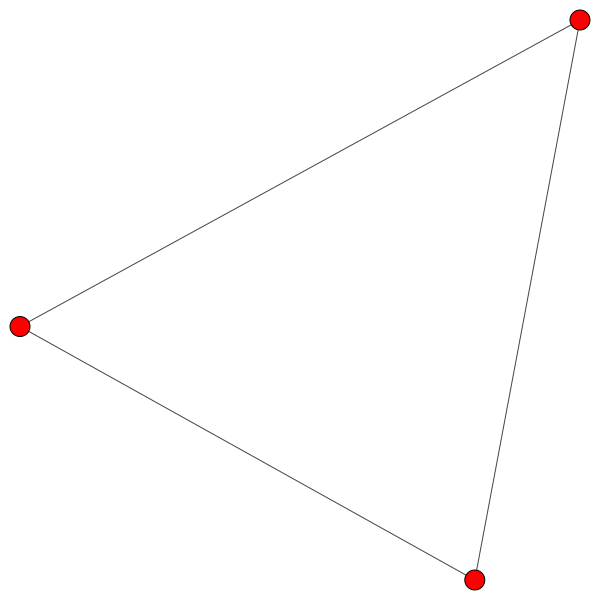

In [10]:
ig.plot(g)

Very exciting :-).

There are a great many things to do with the graph once we have created it, some of which we will explore today.

First lets load our data, the Grimmer corpus:

In [11]:
senReleasesDF = pandas.read_csv('data/senReleasesTraining.csv', index_col = 0)
senReleasesDF[:5]

,download_url,html_url,name,path,text,targetSenator
0,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Apr2005Kennedy14.txt,raw/Kennedy/01Apr2005Kennedy14.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE...,Kennedy
1,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2005Kennedy12.txt,raw/Kennedy/01Aug2005Kennedy12.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE...,Kennedy
2,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2006Kennedy10.txt,raw/Kennedy/01Aug2006Kennedy10.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE ...,Kennedy
3,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2006Kennedy11.txt,raw/Kennedy/01Aug2006Kennedy11.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE ...,Kennedy
4,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2006Kennedy12.txt,raw/Kennedy/01Aug2006Kennedy12.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE ...,Kennedy


We will be extracting sentences, as well as tokenizing and stemming. (You should be able to do this in your sleep now):

In [12]:
def normlizeTokens(tokenLst, stopwordLst = None, stemmer = None, lemmer = None, vocab = None):
    #We can use a generator here as we just need to iterate over it

    #Lowering the case and removing non-words
    workingIter = (w.lower() for w in tokenLst if w.isalpha())

    #Now we can use the semmer, if provided
    if stemmer is not None:
        workingIter = (stemmer.stem(w) for w in workingIter)

    #And the lemmer
    if lemmer is not None:
        workingIter = (lemmer.lemmatize(w) for w in workingIter)

    #And remove the stopwords
    if stopwordLst is not None:
        workingIter = (w for w in workingIter if w not in stopwordLst)

    #We will return a list with the stopwords removed
    if vocab is not None:
        vocab_str = '|'.join(vocab)
        workingIter = (w for w in workingIter if re.match(vocab_str, w))

    return list(workingIter)

stop_words_nltk = nltk.corpus.stopwords.words('english')
snowball = nltk.stem.snowball.SnowballStemmer('english')
wordnet = nltk.stem.WordNetLemmatizer()

For now we will not be dropping any stop words:

In [13]:
senReleasesDF['tokenized_sents'] = senReleasesDF['text'].apply(lambda x: [nltk.word_tokenize(s) for s in nltk.sent_tokenize(x)])
senReleasesDF['normalized_sents'] = senReleasesDF['tokenized_sents'].apply(lambda x: [normlizeTokens(s, stopwordLst = None, stemmer = snowball) for s in x])

senReleasesDF[:5]

,download_url,html_url,name,path,text,targetSenator,tokenized_sents,normalized_sents
0,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Apr2005Kennedy14.txt,raw/Kennedy/01Apr2005Kennedy14.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE...,Kennedy,"[[FOR, IMMEDIATE, RELEASE, FOR, IMMEDIATE, REL...","[[for, immedi, releas, for, immedi, releas, co..."
1,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2005Kennedy12.txt,raw/Kennedy/01Aug2005Kennedy12.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE...,Kennedy,"[[FOR, IMMEDIATE, RELEASE, FOR, IMMEDIATE, REL...","[[for, immedi, releas, for, immedi, releas, co..."
2,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2006Kennedy10.txt,raw/Kennedy/01Aug2006Kennedy10.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE ...,Kennedy,"[[FOR, IMMEDIATE, RELEASE, FOR, IMMEDIATE, REL...","[[for, immedi, releas, for, immedi, releas, wa..."
3,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2006Kennedy11.txt,raw/Kennedy/01Aug2006Kennedy11.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE ...,Kennedy,"[[FOR, IMMEDIATE, RELEASE, FOR, IMMEDIATE, REL...","[[for, immedi, releas, for, immedi, releas, wa..."
4,https://raw.githubusercontent.com/lintool/Grim...,https://github.com/lintool/GrimmerSenatePressR...,01Aug2006Kennedy12.txt,raw/Kennedy/01Aug2006Kennedy12.txt,FOR IMMEDIATE RELEASE FOR IMMEDIATE ...,Kennedy,"[[FOR, IMMEDIATE, RELEASE, FOR, IMMEDIATE, REL...","[[for, immedi, releas, for, immedi, releas, co..."


Let's start by looking at words co-occurring in the same sentences:

In [14]:
def wordCooccurrence(sentences, makeMatrix = False):
    words = set()
    for sent in sentences:
        words |= set(sent)
    wordLst = list(words)
    wordIndices = {w: i for i, w in enumerate(wordLst)}
    wordCoCounts = {}
    #consider a sparse matrix if memory becomes an issue
    coOcMat = np.zeros((len(wordIndices), len(wordIndices)))
    for sent in sentences:
        for i, word1 in enumerate(sent):
            word1Index = wordIndices[word1]
            for word2 in sent[i + 1:]:
                coOcMat[word1Index][wordIndices[word2]] += 1
    if makeMatrix:
        return coOcMat, wordLst
    else:
        coOcMat = coOcMat.T + coOcMat
        edges = list(zip(*np.where(coOcMat)))
        weights = coOcMat[np.where(coOcMat)]
        g = ig.Graph( n = len(wordLst),
            edges = edges,
            vertex_attrs = {'name' : wordLst, 'label' : wordLst},
            edge_attrs = {'weight' : weights}
                    )
        return g

Build a graph based on word cooccurence in the first 100 press releases.

In [15]:
g = wordCooccurrence(senReleasesDF['normalized_sents'][:100].sum())

Total number of vertices:

In [16]:
g.vcount()

4394

Total number of edges:

In [17]:
g.ecount()

4944446

A part of the adjacency matrix of cleaned word by press releases:

In [18]:
g.get_adjacency()[:10, :10]

Matrix([[1, 0, 0, 0, 0, 0, 0, 0, 0, 2], [0, 0, 0, 0, 2, 2, 0, 0, 0, 2], [0, 0, 1, 0, 0, 0, 0, 0, 0, 2], [0, 0, 0, 0, 2, 0, 0, 0, 0, 2], [0, 2, 0, 2, 1, 2, 2, 2, 2, 2], [0, 2, 0, 0, 2, 1, 0, 0, 2, 2], [0, 0, 0, 0, 2, 0, 1, 2, 0, 2], [0, 0, 0, 0, 2, 0, 2, 0, 0, 0], [0, 0, 0, 0, 2, 2, 0, 0, 1, 2], [2, 2, 2, 2, 2, 2, 2, 0, 2, 1]])

We can save the graph and read it later:

In [19]:
g.write_gml('data/Obama_words.gml')

Or, we can build graphs starting with a two-mode network. Let's again use the document-word frequency matrix that we used in week 3.

In [20]:
def tokenize(text):
    tokenlist = nltk.word_tokenize(text)
    normalized = normlizeTokens(tokenlist, stemmer = snowball)
    return normalized

In [21]:
senVectorizer = sklearn.feature_extraction.text.CountVectorizer(stop_words=stop_words_nltk, tokenizer = tokenize)
senVects = senVectorizer.fit_transform(senReleasesDF['text'][:100])

In [22]:
senVects.shape

(100, 4270)

We need to turn the matrix into a list as our input.

In [23]:
INP = senVects.todense().tolist()

In [24]:
g = ig.Graph.Incidence(INP, multiple=True)

We can check whether it is a bipartite network.

In [25]:
g.is_bipartite()

True

Give colors and shapes to documents and words:

In [26]:
g.vs['color']  = ['red']*senVects.shape[0] + ['blue']*senVects.shape[1]
g.vs['shape']  = ['square']*senVects.shape[0] + ['circle']*senVects.shape[1]

A very popular layout algorithm for visualizing graphs is the Fruchterman-Reingold Algorithm, which uses a physical metaphor for lay-out. Nodes repel one another, and edges draw connected elements together like springs. The algorithm attempts to minimize the energy in such a system. For a large graph, however, the algorithm is computational demanding. The commented code gives you a layout and you can save it as a pickle. Let's then load a layout.

In [27]:
#These take a long time
#layout = g.layout_fruchterman_reingold()
#pickle.dump(layout, open( "layout.pkl", "wb" ) )
#layout = pickle.load(open('layout.pkl','rb'))

Then, let's plot the bipartite network:

In [28]:
ig.plot(g, layout = None, vertex_size = 5)

A faster algorithm for large networks is the Large Graph Layout algorithm. If we want even faster computation and tunable visualizations, check out [Pajek](http://mrvar.fdv.uni-lj.si/pajek/) or [gephi](https://gephi.org/).

In [29]:
layout = g.layout_lgl()
ig.plot(g, layout = layout, vertex_size = 5)

A two-mode network can be easily transformed into two one-mode network, enabling words to be connected to other words via the number of documents that share them, or documents to be connected to other documents via the words they share.

In [30]:
gDoc, gWord = g.bipartite_projection()

Let's first take a look at the document-to-document network:

In [31]:
gDoc.summary()

'IGRAPH U-WT 100 4950 -- \n+ attr: color (v), shape (v), type (v), weight (e)'

Let's do a visualization. It is not surprising that almost every document is connected to every one else. We can use edge weight to distinguish distance (modeled as attraction) between the nodes.

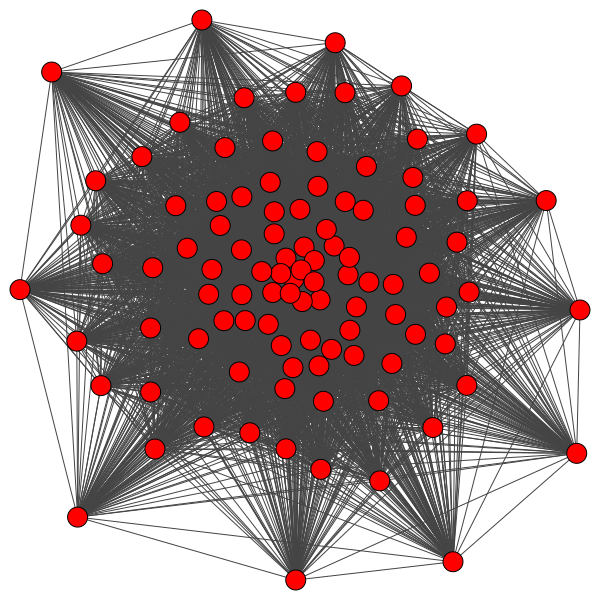

In [32]:
layout = gDoc.layout_fruchterman_reingold(weights = gDoc.es['weight'])
ig.plot(gDoc, layout = layout, vertex_shape = 'circle')

Another way to visualize the graph is to binarize the adjacency matrix with some cutoff values for edge weight. Let's use the medianw weight as our cutoff threshhold.

In [33]:
median = np.median(gDoc.es['weight'])
medEdges = gDoc.es.select(lambda x: x['weight'] > median)
g1_d = gDoc.subgraph_edges(medEdges)

In [34]:
g1_d.summary()

'IGRAPH U-WT 97 2470 -- \n+ attr: color (v), shape (v), type (v), weight (e)'

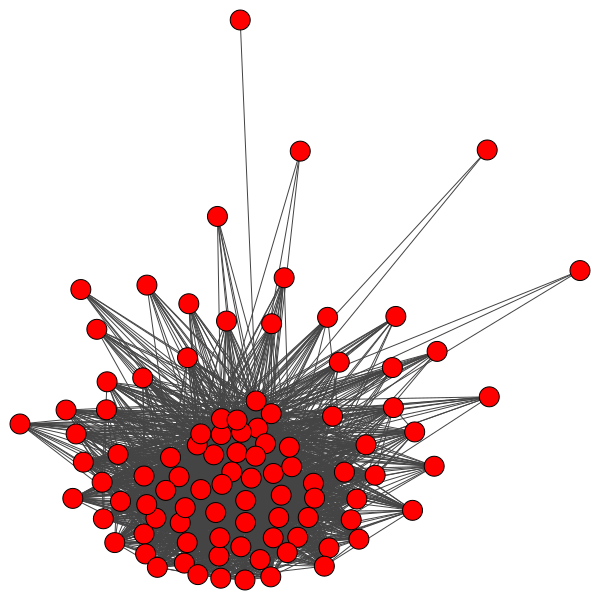

In [35]:
layout = g1_d.layout_fruchterman_reingold()
ig.plot(g1_d, layout = layout, vertex_shape = 'circle')

Now let's turn it around and look at the word-to-word network (via documents). Instead of working directly with `gWord`, let's start with matrix multiplication which gives us more freedom to define edge weight. First, let's reduce the number of words to a manageable size.

In [36]:
senVectorizer = sklearn.feature_extraction.text.CountVectorizer(stop_words=stop_words_nltk, tokenizer = tokenize, max_features = 200)
senVects = senVectorizer.fit_transform(senReleasesDF['text'][:100])
wordsLst = senVectorizer.get_feature_names()
senVects.shape

(100, 200)

Let's define the weight of an edge to the be the number of document coocurrences of two words divided by the square root of the product of their marginal frequencies.

In [37]:
A = senVects.todense() #Get the doc-word frequency matrix.
M = np.sum(A, axis = 0) #The marginal frequencies are simplies the column sums.
W = A.T.dot(A)/np.sqrt(M.T.dot(M)) #Get out weight matrix.
np.fill_diagonal(W,0) #Set the diagonal to zero.

In [38]:
G = ig.Graph.Weighted_Adjacency(W.tolist(), mode=ig.ADJ_UNDIRECTED)
G.vs['name'] = wordsLst #Names are what you reference
G.vs['label'] = wordsLst #Label are what is displayed

Now, let's visualize this:

In [39]:
layout = G.layout_fruchterman_reingold()

In [40]:
ig.plot(G, layout = layout, vertex_size = 0, edge_width = 0.1)

Even better, we can input the weight matrix with some cutoff value. We use 4 for now as it is useful for demonstration, but you can explore:

In [41]:
cutoff = 4
G_b = G.subgraph_edges(G.es.select(lambda x: x['weight'] > cutoff))

In [42]:
G_b = G.subgraph_edges(G.es.select(weight_gt = cutoff))

In [43]:
layout = G_b.layout_fruchterman_reingold()

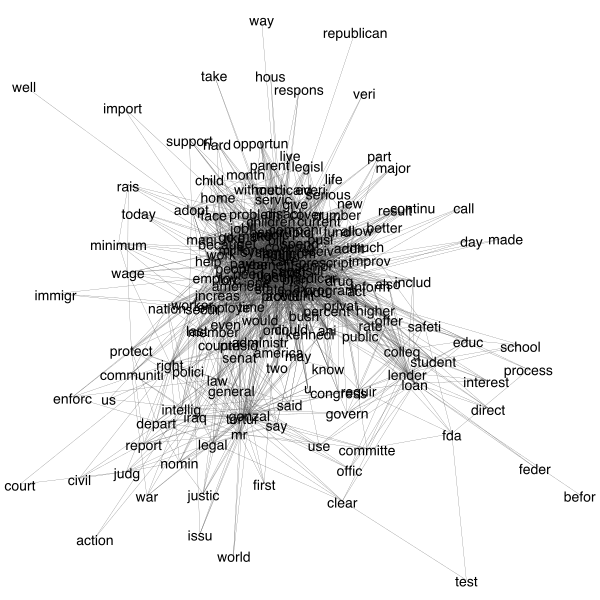

In [44]:
ig.plot(G_b, layout = layout, vertex_size = 0, edge_width = 0.2)

We can continue to trim globally or locally, to investigate the structure of words around a core word of interest.

#Can we do an example of this...visualize just the neighborhood of a word...e.g., the word and all words most closely connected and their close connections (friend of a friend)?

## <span style="color:red">*Your Turn*</span>

<span style="color:red">Construct cells immediately below this that render some reasonable networks to meaningfully characterize the structure of words and documents (or subdocuments like chapters or paragraphs) from your corpus. Also create some smaller, word neighborhood graphs. What are useful filters and thresholds and what semantic structures do they reveal that given insight into the social world and social game inscribed in your corpus?

Alternatively, there are some more informative networks statistics.

Lets begin with measures of centrality. The concept of centrality is that some nodes (words or documents) are more *central* to the network than others. There are many distinct and opposing operationalizations of this concept, however. One important concept is *betweenness* centrality, which distinguishes nodes that require the most shortest pathways between all other nodes in the network. Semantically, words with a high betweenness centrality may link distinctive domains, rather than being "central" to any one. 

In [45]:
G_b.vs[np.argmax(G_b.betweenness())]

igraph.Vertex(<igraph.Graph object at 0x10f1938b8>, 63, {'label': 'health', 'name': 'health'})

We can color and size the nodes by betweenness centrality:

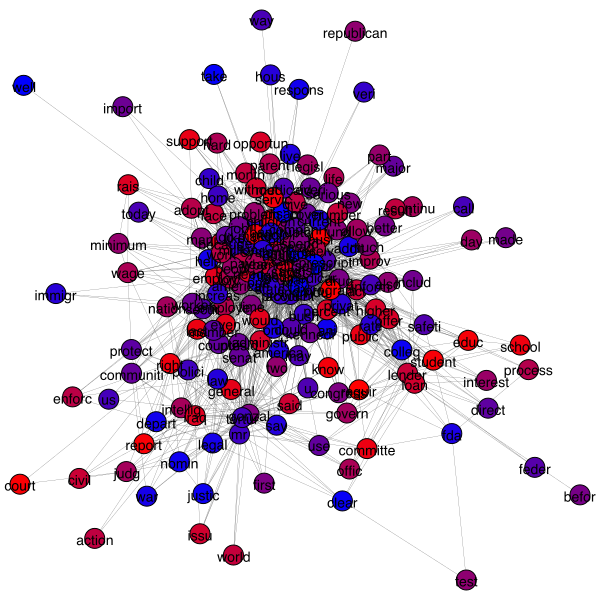

In [46]:
pal = ig.GradientPalette("red", "blue", G_b.vcount())
G_b.vs['color'] = [pal.get(int(v)) for v in np.argsort(G_b.betweenness())]
ig.plot(G_b, layout = layout, edge_width = 0.2)

The distrubution of betweenness centrality is:

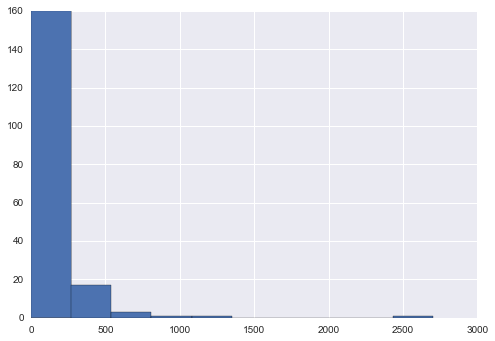

In [47]:
plt.hist(G_b.betweenness())
plt.show()

Or if we set a max of 500

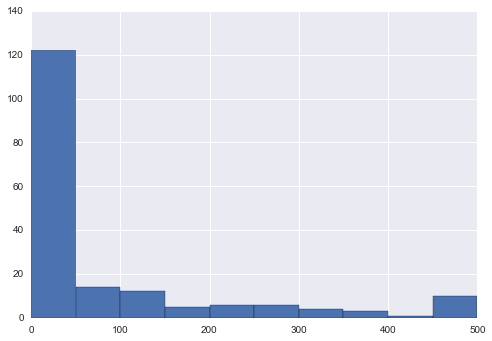

In [48]:
plt.hist([min(b, 500) for b in G_b.betweenness()])
plt.show()

This is an exponential distrubution.

Another way to visualize the graph involes the use of label sizes to represent betweenness centrality and edge widths to represent edge weight:

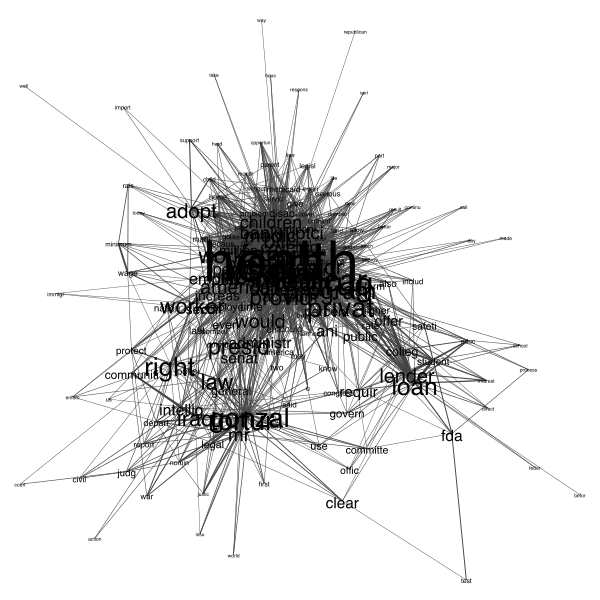

In [112]:
edge_width = (np.array(G_b.es['weight'])*0.1).tolist()
size = (5 + np.sqrt(np.array(G_b.betweenness()))).tolist()
ig.plot(G_b, layout = layout, vertex_size = 0, vertex_label_size = size, edge_width = edge_width)

Here it appears that "health"/"drug", "torture"/"Iraq", and "loan"/"lend" are key concepts that connect others in the broader network. This is interesting in that they seem to be a domain-specific rather than linking words like "require" and "govern".

What are the top ten words in terms of betweenness?

In [50]:
sorted(zip(G_b.vs['name'], G_b.betweenness()), key = lambda x: x[1], reverse = True)[:10]

[('health', 2700.4466905456434),
 ('care', 1173.9766778186765),
 ('drug', 830.52856730275),
 ('medicar', 702.2508272972119),
 ('famili', 641.4117571225346),
 ('cost', 548.7198460962526),
 ('year', 539.3837673309041),
 ('privat', 506.70870664665586),
 ('tortur', 505.275398939186),
 ('gonzal', 491.65152386140574)]

What are words further down (the lowest all have centralities of 0):

In [51]:
sorted(zip(G_b.vs['name'], G_b.betweenness()), key = lambda x: x[1], reverse = True)[140:150]

[('live', 1.0768283622852464),
 ('without', 0.7103514496467788),
 ('number', 0.6038394923002777),
 ('us', 0.5938992854336986),
 ('import', 0.5177792190310697),
 ('support', 0.5177792190310697),
 ('immigr', 0.4610535080640253),
 ('month', 0.43965525500728103),
 ('addit', 0.3202144361428302),
 ('new', 0.24886416556800936)]

Alternatively, we can look at degree centrality, which is simply the number of connections possessed by each node.

In [52]:
G_b.vs[np.argmax(G_b.degree())]

igraph.Vertex(<igraph.Graph object at 0x10f1938b8>, 63, {'name': 'health', 'label': 'health', 'color': (0.543956043956044, 0.0, 0.45604395604395603, 1.0)})

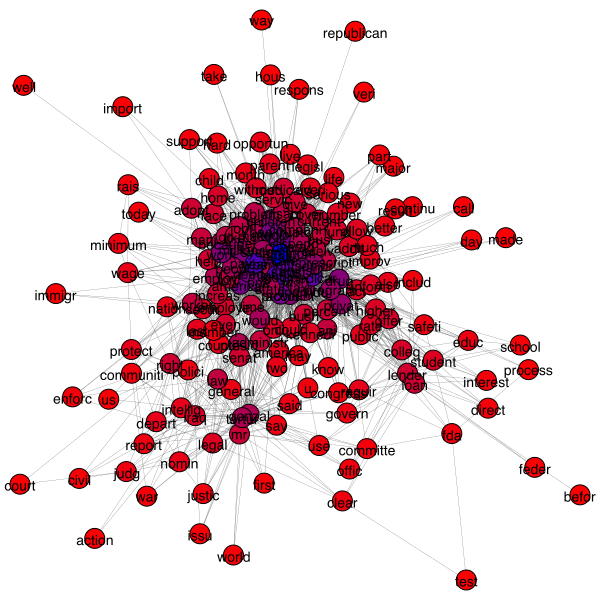

In [53]:
pal = ig.GradientPalette("red", "blue", max(G_b.degree()) + 1)
G_b.vs['color'] = [pal.get(v) for v in G_b.degree()]
ig.plot(G_b, layout = layout, edge_width = 0.2)

The top 10 words by degree are:

In [54]:
sorted(zip(G_b.vs['name'], G_b.degree()), key = lambda x: x[1], reverse = True)[:10]

[('health', 130),
 ('care', 115),
 ('cost', 101),
 ('year', 91),
 ('insur', 89),
 ('plan', 87),
 ('medicar', 83),
 ('save', 81),
 ('famili', 80),
 ('provid', 71)]

And the bottom 10:

In [55]:
sorted(zip(G_b.vs['name'], G_b.degree()), key = lambda x: x[1], reverse = False)[:10]

[('befor', 1),
 ('republican', 1),
 ('way', 1),
 ('well', 1),
 ('action', 2),
 ('court', 2),
 ('feder', 2),
 ('hous', 2),
 ('import', 2),
 ('made', 2)]

The distrubtioon of degree looks like

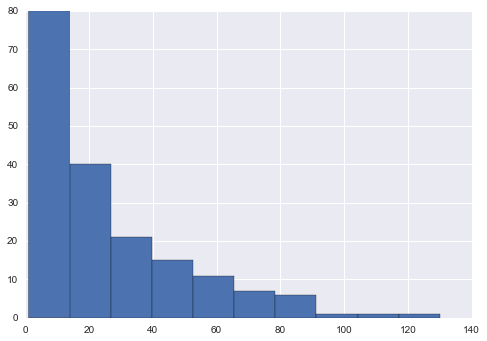

In [56]:
plt.hist(G_b.degree())
plt.show()

We can also look at closeness centrality, or the average Euclidean or path distance between a node and all others in the network. A node with the highest closeness centrality is most likely to send a signal with the most coverage to the rest of the network.

In [57]:
G_b.vs[np.argmax(G_b.closeness())]

igraph.Vertex(<igraph.Graph object at 0x10f1938b8>, 63, {'name': 'health', 'label': 'health', 'color': (0.0, 0.0, 1.0, 1.0)})

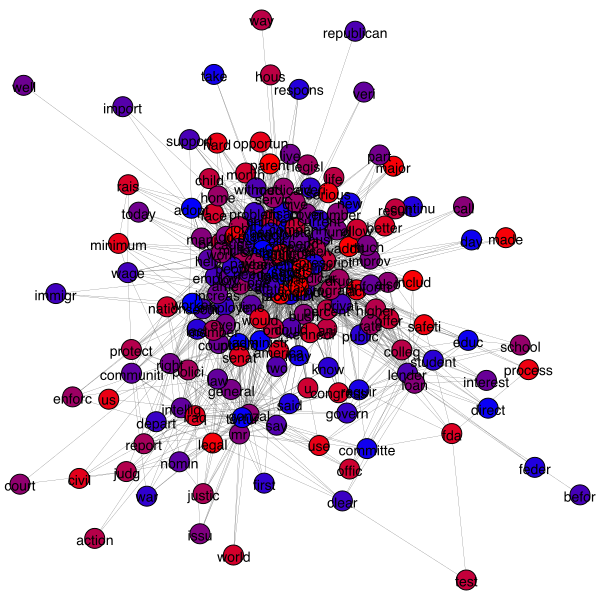

In [58]:
pal = ig.GradientPalette("red", "blue", G_b.vcount())
G_b.vs['color'] = [pal.get(int(v)) for v in np.argsort(G_b.closeness())]
ig.plot(G_b, layout = layout, edge_width = 0.2)

Top and bottom:

In [59]:
sorted(zip(G_b.vs['name'], G_b.closeness()), key = lambda x: x[1], reverse = True)[:10]

[('health', 0.7489711934156379),
 ('care', 0.7054263565891473),
 ('cost', 0.6618181818181819),
 ('year', 0.6476868327402135),
 ('insur', 0.6385964912280702),
 ('plan', 0.6254295532646048),
 ('medicar', 0.6148648648648649),
 ('famili', 0.6086956521739131),
 ('save', 0.6066666666666667),
 ('provid', 0.6046511627906976)]

In [60]:
sorted(zip(G_b.vs['name'], G_b.closeness()), key = lambda x: x[1], reverse = False)[:10]

[('test', 0.30743243243243246),
 ('befor', 0.3116438356164384),
 ('feder', 0.3127147766323024),
 ('action', 0.3132530120481928),
 ('well', 0.32616487455197135),
 ('world', 0.3351749539594843),
 ('court', 0.3364140480591497),
 ('issu', 0.3479923518164436),
 ('civil', 0.35546875),
 ('immigr', 0.3603960396039604)]

Or eignvector centrality, an approach that weights degree by the centrality of those to whom one is tied (and the degree to whom they are tied, etc.) In short, its an $n$th order degree measure.

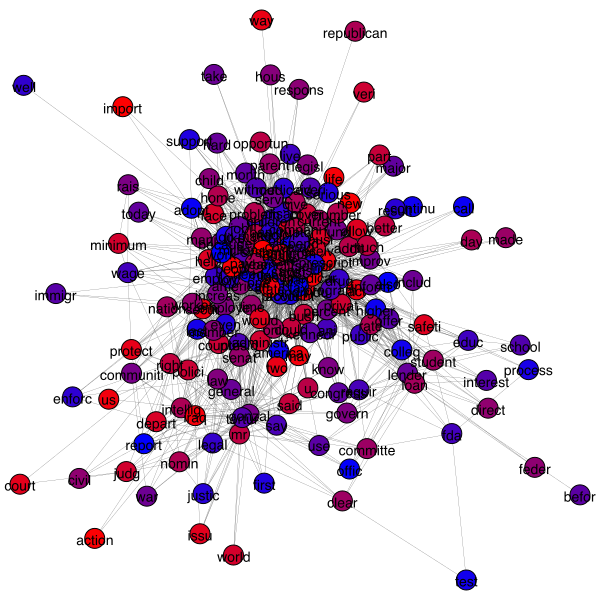

In [61]:
G_b.vs['color'] = [pal.get(int(v)) for v in np.argsort(G_b.eigenvector_centrality())]
ig.plot(G_b, layout = layout, edge_width = 0.2)

Top and bottom:

In [62]:
sorted(zip(G_b.vs['name'], G_b.eigenvector_centrality()), key = lambda x: x[1], reverse = True)[:10]

[('health', 0.9999999999999999),
 ('care', 0.9798548782794725),
 ('cost', 0.942412516766161),
 ('insur', 0.90307832133953),
 ('year', 0.8965787861759374),
 ('plan', 0.8545673629049791),
 ('save', 0.8363780668746117),
 ('benefit', 0.8053067456113232),
 ('medicar', 0.7807664316655794),
 ('provid', 0.7771397696907315)]

In [63]:
sorted(zip(G_b.vs['name'], G_b.eigenvector_centrality()), key = lambda x: x[1], reverse = False)[:10]

[('test', 0.0006657407127056398),
 ('befor', 0.001922337105224982),
 ('action', 0.0024324778932577566),
 ('feder', 0.003850990977444753),
 ('court', 0.004236425895881124),
 ('well', 0.004249882664290007),
 ('civil', 0.006668903789138867),
 ('world', 0.00805015631361058),
 ('war', 0.009458248568250189),
 ('issu', 0.009465330480131184)]

## <span style="color:red">*Your Turn*</span>

<span style="color:red">Construct cells immediately below this that calculate different kinds of centrality for distinct words or documents in a network composed from your corpus of interest. Which type of words tend to be most and least central? Can you identify how different centrality measures distinguish different kind of words in your corpus? What do these patterns suggest about the semantic content and structure of your documents?

We can also look at global statistics, like the density of a network, defined as the number of edges existing divided by the total number of edges possible:

In [64]:
G_b.density()

0.14123581336696092

We can also calculate the average degree per node:

In [65]:
np.mean(G_b.degree())

25.704918032786885

The diameter calculates the average distance between any two nodes in the network:

In [66]:
G_b.diameter()

5

Moreover, we can find cliques, or completely connected sets of nodes:

In [67]:
G_b.largest_cliques()

[(63,
  20,
  31,
  78,
  126,
  148,
  182,
  14,
  36,
  104,
  118,
  9,
  135,
  169,
  0,
  76,
  162,
  74,
  65,
  156,
  160,
  102,
  123,
  94,
  99),
 (63,
  20,
  31,
  78,
  126,
  148,
  182,
  14,
  36,
  104,
  118,
  9,
  135,
  169,
  0,
  76,
  162,
  74,
  65,
  156,
  160,
  102,
  123,
  94,
  69),
 (63,
  20,
  31,
  78,
  126,
  148,
  182,
  14,
  36,
  104,
  118,
  9,
  135,
  169,
  0,
  76,
  162,
  74,
  65,
  156,
  160,
  102,
  123,
  94,
  44),
 (63,
  20,
  31,
  78,
  126,
  148,
  182,
  14,
  36,
  104,
  118,
  9,
  135,
  169,
  0,
  76,
  162,
  74,
  65,
  156,
  160,
  102,
  123,
  83,
  69),
 (63,
  20,
  31,
  78,
  126,
  148,
  182,
  14,
  36,
  104,
  118,
  9,
  135,
  169,
  0,
  76,
  162,
  74,
  65,
  156,
  160,
  102,
  123,
  83,
  44)]

In [68]:
print(', '.join((G_b.vs[i]['name'] for i in G_b.largest_cliques()[0])))

health, care, cost, insur, plan, save, year, benefit, coverag, medicar, one, american, provid, uninsur, account, individu, tax, incom, high, spend, system, medic, pay, like, make


Now lets look at a subgraph of the network, those nodes that are within 2 edges 'war'.

In [69]:
warNeighbors = G_b.neighbors('war')
warNeighborsPlus1 = set(warNeighbors)
for n in warNeighbors:
    warNeighborsPlus1 |= set(G_b.neighbors(n))

In [70]:
G_war = G_b.subgraph(G_b.vs.select(warNeighborsPlus1))
G_war.vcount()

58

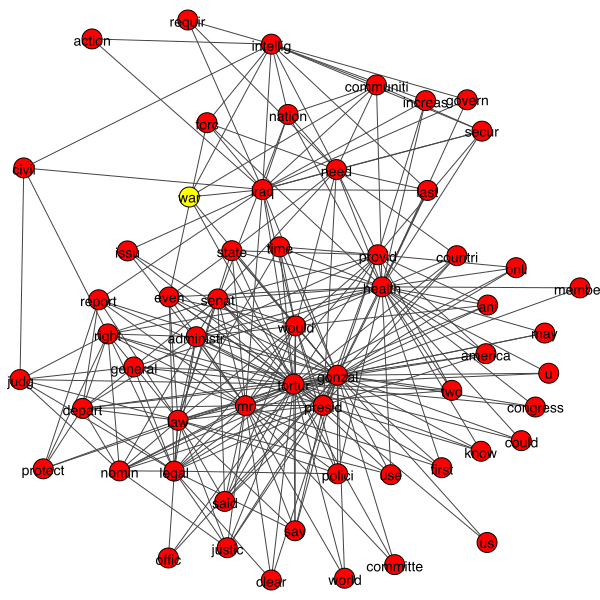

In [71]:
G_war.vs['color'] = 'red'
G_war.vs.find('war')['color'] = 'yellow'
ig.plot(G_war, target = 'data/war_plot.png')

There is a bug in iGraph that causes some plots to display incorrectly, but the svgs they produce are unaffected. So we can just display the svgs with Ipython.

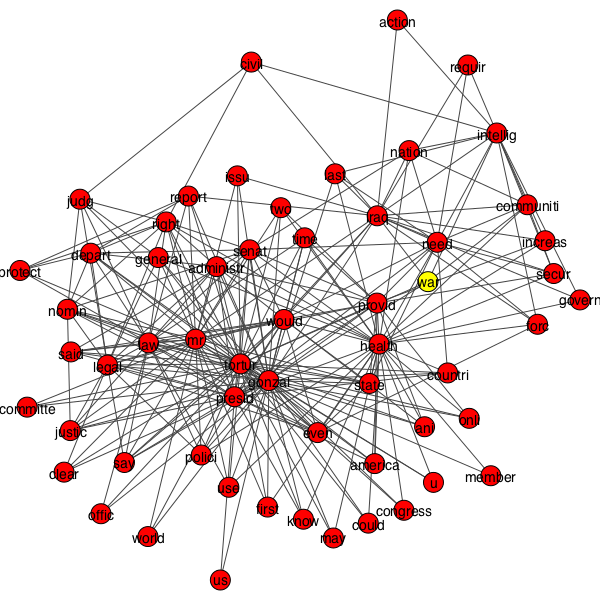

In [72]:
IPython.display.Image('data/war_plot.png')

# POS based networks

Now lets look at links between specific parts of speech within a network.

For this we will be using the `nltk` POS facilities instead of the Stanford ones. These are much faster, but also somewhat less accurate. (You get what you *pay* for in computational power).

Lets look at nouns co-occurring in sentences using the top 10 (by score) reddit posts:

In [73]:
redditDF = pandas.read_csv('data/reddit.csv', index_col = 0)

In [74]:
redditTopScores = redditDF.sort_values('score')[-100:]
redditTopScores['sentences'] = redditTopScores['text'].apply(lambda x: [nltk.word_tokenize(s) for s in nltk.sent_tokenize(x)])
redditTopScores.index = range(len(redditTopScores) - 1, -1,-1) #Reindex to make things nice in the future
redditTopScores

,author,over_18,score,subreddit,text,title,url,sentences
99,jimmy_three_shoes,False,4990,Tales From Tech Support,"This happened a little while ago, when I was c...","We've tried nothing, and we're all out of ideas!",https://www.reddit.com/r/talesfromtechsupport/...,"[[This, happened, a, little, while, ago, ,, wh..."
98,badbfriend,False,5034,Relationships,https://www.reddit.com/r/relationships/comment...,"Me [29 M] with my g/f [27 F] together 4 years,...",https://www.reddit.com/r/relationships/comment...,"[[https, :, //www.reddit.com/r/relationships/c..."
97,Fafrdr,False,5146,Relationships,First post: https://www.reddit.com/r/relations...,Update - My [16F] father [59M] acts creepy tow...,https://www.reddit.com/r/relationships/comment...,"[[First, post, :, https, :, //www.reddit.com/r..."
96,Eshyj,False,5154,Tales From Tech Support,Link to my recent TFTS [All I wanted was sleep...,Sir are you saying you'd like for me to overpo...,https://www.reddit.com/r/talesfromtechsupport/...,"[[Link, to, my, recent, TFTS, [, All, I, wante..."
95,DivinePrinterGod,False,5220,Tales From Tech Support,"In England, we don't have a gun culture so it ...",Surrounded by armed officers,https://www.reddit.com/r/talesfromtechsupport/...,"[[In, England, ,, we, do, n't, have, a, gun, c..."
94,[deleted],False,5244,Tales From Tech Support,I work at a hospital. Doctors are the worst p...,So the kid in the mail room with down syndrome...,https://www.reddit.com/r/talesfromtechsupport/...,"[[I, work, at, a, hospital, .], [Doctors, are,..."
93,Nowwhat8989,False,5278,Relationships,**Hope this isn't against the rules or anythin...,UPDATE2: I (22M) just walked in on my girlfrie...,https://www.reddit.com/r/relationships/comment...,"[[**Hope, this, is, n't, against, the, rules, ..."
92,bobcat,False,5324,Tales From Tech Support,tl;dr Did that just happen? I was a System/36...,The Day I Called IBM Tech Support,https://www.reddit.com/r/talesfromtechsupport/...,"[[tl, ;, dr, Did, that, just, happen, ?], [I, ..."
91,Familyheiress,False,5346,Relationships,So I didn't automatically dump my boyfriend. I...,Boyfriend (28m) found out how much money I (28...,https://www.reddit.com/r/relationships/comment...,"[[So, I, did, n't, automatically, dump, my, bo..."
90,Zarokima,False,5367,Tales From Tech Support,"First off, I've never actually done tech suppo...","My first day on the job, and I accidentally go...",https://www.reddit.com/r/talesfromtechsupport/...,"[[First, off, ,, I, 've, never, actually, done..."


Now we'll normalize the tokens through stemming:

In [75]:
redditTopScores['normalized_sents'] = redditTopScores['sentences'].apply(lambda x: [normlizeTokens(s, stopwordLst = None, stemmer = snowball) for s in x])

In [76]:
redditTopScores

,author,over_18,score,subreddit,text,title,url,sentences,normalized_sents
99,jimmy_three_shoes,False,4990,Tales From Tech Support,"This happened a little while ago, when I was c...","We've tried nothing, and we're all out of ideas!",https://www.reddit.com/r/talesfromtechsupport/...,"[[This, happened, a, little, while, ago, ,, wh...","[[this, happen, a, littl, while, ago, when, i,..."
98,badbfriend,False,5034,Relationships,https://www.reddit.com/r/relationships/comment...,"Me [29 M] with my g/f [27 F] together 4 years,...",https://www.reddit.com/r/relationships/comment...,"[[https, :, //www.reddit.com/r/relationships/c...","[[https, first, let, me, say, that, when, i, w..."
97,Fafrdr,False,5146,Relationships,First post: https://www.reddit.com/r/relations...,Update - My [16F] father [59M] acts creepy tow...,https://www.reddit.com/r/relationships/comment...,"[[First, post, :, https, :, //www.reddit.com/r...","[[first, post, https, i, told, my, brother, ev..."
96,Eshyj,False,5154,Tales From Tech Support,Link to my recent TFTS [All I wanted was sleep...,Sir are you saying you'd like for me to overpo...,https://www.reddit.com/r/talesfromtechsupport/...,"[[Link, to, my, recent, TFTS, [, All, I, wante...","[[link, to, my, recent, tfts, all, i, want, wa..."
95,DivinePrinterGod,False,5220,Tales From Tech Support,"In England, we don't have a gun culture so it ...",Surrounded by armed officers,https://www.reddit.com/r/talesfromtechsupport/...,"[[In, England, ,, we, do, n't, have, a, gun, c...","[[in, england, we, do, have, a, gun, cultur, s..."
94,[deleted],False,5244,Tales From Tech Support,I work at a hospital. Doctors are the worst p...,So the kid in the mail room with down syndrome...,https://www.reddit.com/r/talesfromtechsupport/...,"[[I, work, at, a, hospital, .], [Doctors, are,...","[[i, work, at, a, hospit], [doctor, are, the, ..."
93,Nowwhat8989,False,5278,Relationships,**Hope this isn't against the rules or anythin...,UPDATE2: I (22M) just walked in on my girlfrie...,https://www.reddit.com/r/relationships/comment...,"[[**Hope, this, is, n't, against, the, rules, ...","[[this, is, against, the, rule, or, anyth, but..."
92,bobcat,False,5324,Tales From Tech Support,tl;dr Did that just happen? I was a System/36...,The Day I Called IBM Tech Support,https://www.reddit.com/r/talesfromtechsupport/...,"[[tl, ;, dr, Did, that, just, happen, ?], [I, ...","[[tl, dr, did, that, just, happen], [i, was, a..."
91,Familyheiress,False,5346,Relationships,So I didn't automatically dump my boyfriend. I...,Boyfriend (28m) found out how much money I (28...,https://www.reddit.com/r/relationships/comment...,"[[So, I, did, n't, automatically, dump, my, bo...","[[so, i, did, automat, dump, my, boyfriend], [..."
90,Zarokima,False,5367,Tales From Tech Support,"First off, I've never actually done tech suppo...","My first day on the job, and I accidentally go...",https://www.reddit.com/r/talesfromtechsupport/...,"[[First, off, ,, I, 've, never, actually, done...","[[first, off, i, never, actual, done, tech, su..."


In [77]:
def posCooccurrence(sentences, *posType, makeMatrix = False):
    pal = ig.RainbowPalette(n = len(posType))
    palMap = {p : pal.get(i) for i, p in enumerate(posType)}
    words = set()
    reducedSents = []
    #Only using the first kind of POS for each word
    wordsMap = {}
    for sent in sentences:
        s = [(w, t) for w, t in nltk.pos_tag(sent) if t in posType]
        for w, t in s:
            if w not in wordsMap:
                wordsMap[w] = t
        reducedSent = [w for w, t in s]
        words |= set(reducedSent)
        reducedSents.append(reducedSent)
    wordLst = list(words)
    wordIndices = {w: i for i, w in enumerate(wordLst)}
    wordCoCounts = {}
    #consider a sparse matrix if memory becomes an issue
    coOcMat = np.zeros((len(wordIndices), len(wordIndices)))
    for sent in reducedSents:
        for i, word1 in enumerate(sent):
            word1Index = wordIndices[word1]
            for word2 in sent[i + 1:]:
                coOcMat[word1Index][wordIndices[word2]] += 1
    if makeMatrix:
        return coOcMat, wordLst
    else:
        coOcMat = coOcMat.T + coOcMat
        edges = list(zip(*np.where(coOcMat)))
        weights = coOcMat[np.where(coOcMat)]
        kinds = [wordsMap[w] for w in wordLst]
        colours = [palMap[k] for k in kinds]
        g = ig.Graph( n = len(wordLst),
            edges = edges,
            vertex_attrs = {'name' : wordLst, 
                            'label' : wordLst, 
                            'kind' : kinds,
                            'color' : colours,
                           },
            edge_attrs = {'weight' : weights})
        return g

In [78]:
gNN = posCooccurrence(redditTopScores['normalized_sents'].sum(), 'NN')

In [79]:
gNN.vcount()

2628

This is a bit to large to effectively visilize, so let's remove the verices whose degree is less than or equal to 100:

In [80]:
gNN_d = gNN.subgraph(gNN.vs.select(lambda x: x.degree() > 100))

In [81]:
gNN_d.vcount()

218

In [82]:
ig.plot(gNN_d, target = 'data/gNN_d.png')

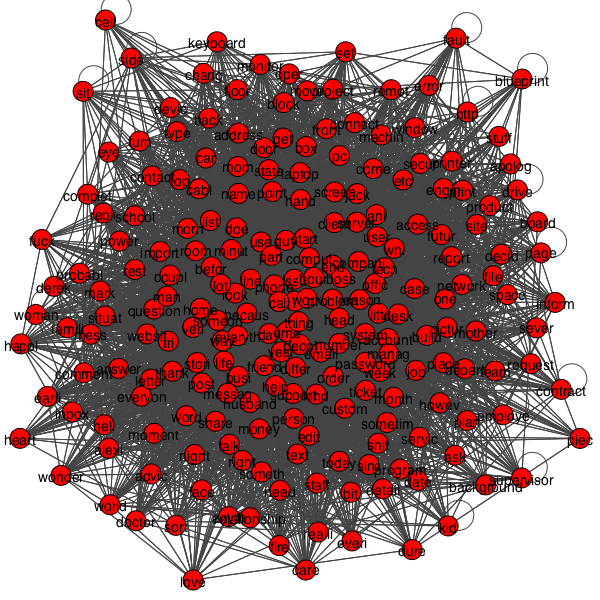

In [83]:
IPython.display.Image('data/gNN_d.png')

This is still a hairball because we retained the most highly connected veritices. Let's trim a few edges as well.

In [84]:
gNN_d.ecount()

11021

In [85]:
gNN_d = gNN_d.subgraph_edges(gNN_d.es.select(lambda x: x['weight'] > 10))

In [86]:
gNN_d.ecount()

242

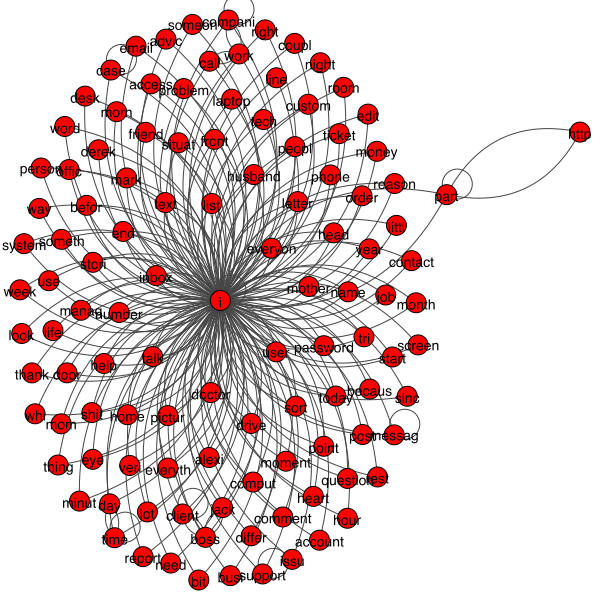

In [87]:
#I know what the graph is like and the default layout is fine
ig.plot(gNN_d, target ='data/gNN_d2.png')

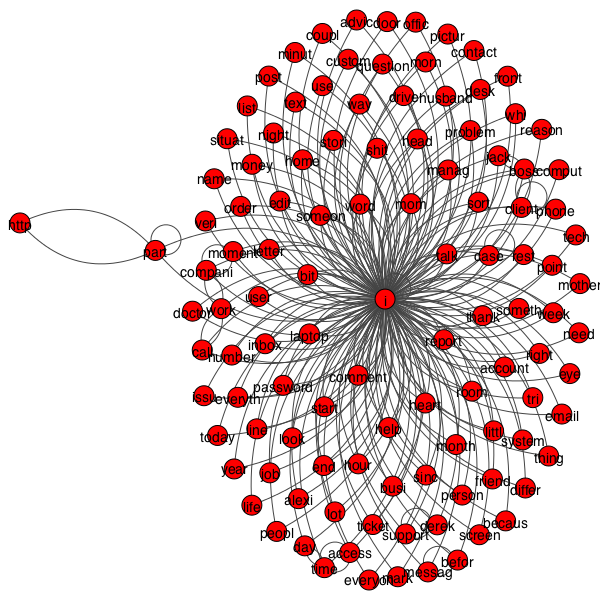

In [88]:
IPython.display.Image('data/gNN_d2.png')

That is an interesting pattern, everyone is talking about themselves ("I...this", "I...that"). <span style="color:red">**How do you interpret all those self loops?**

In [89]:
for e in gNN_d.es.select(lambda x: x.is_loop()):
    print(gNN_d.vs[e.source])

igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 1, {'name': 'compani', 'label': 'compani', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 3, {'name': 'time', 'label': 'time', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 8, {'name': 'messag', 'label': 'messag', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 15, {'name': 'support', 'label': 'support', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 35, {'name': 'i', 'label': 'i', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 89, {'name': 'case', 'label': 'case', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at 0x116f6c408>, 90, {'name': 'client', 'label': 'client', 'kind': 'NN', 'color': (1.0, 0.0, 0.0, 1.0)})
igraph.Vertex(<igraph.Graph object at

What if we want to look at noun-verb pairs instead?

In [90]:
gNV = posCooccurrence(redditTopScores['normalized_sents'].sum(), 'NN', 'VB')

`gNV` has co-occurrences between nouns and nouns as well as between verbs and verbs. Let's remove these and make it purely about noun and verb combinations:

In [91]:
gNV.ecount()

80656

In [92]:
gNV_p = gNV.subgraph_edges(gNV.es.select(lambda x: gNV.vs[x.source]['kind'] != gNV.vs[x.target]['kind']))

In [93]:
gNV_p.ecount()

26654

Dropping low weight edges and low degree vertices again gives us:

In [94]:
gNV_p = gNV_p.subgraph(gNV_p.vs.select(lambda x: x.degree() > 50))
gNV_p = gNV_p.subgraph_edges(gNV_p.es.select(lambda x: x['weight'] > 5))

In [95]:
gNV_p.vcount()

121

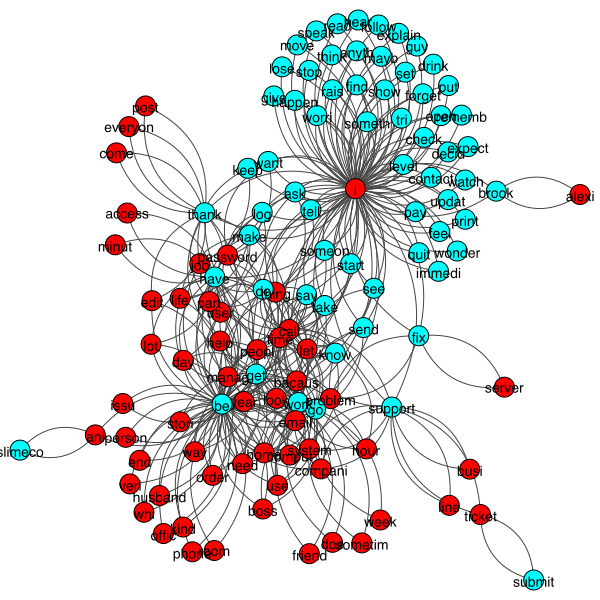

In [96]:
layoutNV = gNV_p.layout_fruchterman_reingold()
ig.plot(gNV_p, layout = layoutNV, target = 'data/gNV_p.png')

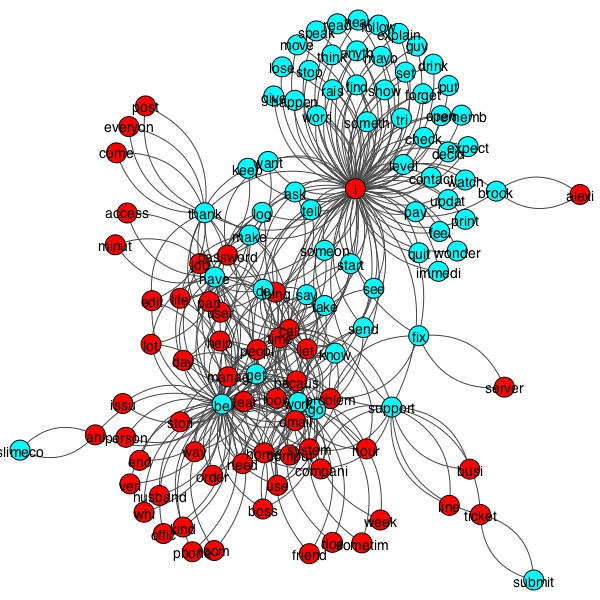

In [97]:
IPython.display.Image('data/gNV_p.png')

Looking at this plot it looks like `I` and `be` are the centers of two communities. Lets check this by partitioning the networks, a graphical method of clustering. Our first approach will use the information theoretic infomap algorithm:

In [98]:
print(gNV_p.community_infomap(edge_weights = gNV_p.es['weight']))

Clustering with 121 elements and 22 clusters
[ 0] show, tri, stop, get, feel, level, set, anyth, explain, expect, rais,
     watch, find, mayb, lose, follow, quit, decid, immedi, ask, move, i,
     order, check, contact, think, speak, hear, updat, happen, worri, pay,
     print, someth, someon, give, wonder, rememb, forget, drink, put, read,
     open, guy
[ 1] phone, end, comput, issu, use, kind, whi, husband, offic, veri, room, be,
     help, way, person, stori
[ 2] tell, thing, year, do, peopl
[ 3] work, need
[ 4] week, manag, home, go, boss, sometim
[ 5] day, minut, have, lot, access
[ 6] edit, post, part, everyon, thank, come
[ 7] compani, system, busi, support, line
[ 8] start, call, friend, doe
[ 9] know, becaus, hour
[10] say, time
[11] see, let
[12] look, take
[13] fix, problem, server
[14] life, make
[15] password, want
[16] user, log
[17] send, email
[18] job, keep
[19] submit, ticket
[20] ani, slimeco
[21] alexi, brook


Let's focus on one of these communities and create an "ego network" surrounding a single (important) word:

In [99]:
gNV_I = gNV.subgraph(gNV.vs.find('i').neighbors())
#Still need to filter it a bit to display
gNV_I.vcount()

1783

In [100]:
gNV_I = gNV_I.subgraph(gNV_I.vs.select(lambda x: x.degree() > 10))
gNV_I = gNV_I.subgraph_edges(gNV_I.es.select(lambda x: x['weight'] > 15))

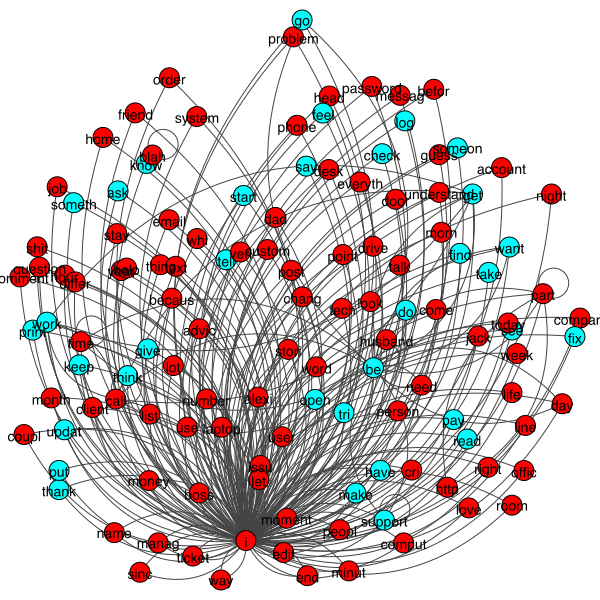

In [101]:
layoutNV_I = gNV_I.layout_fruchterman_reingold(repulserad = .001)
ig.plot(gNV_I, layout = layoutNV_I, target = 'data/gNV_I.png')

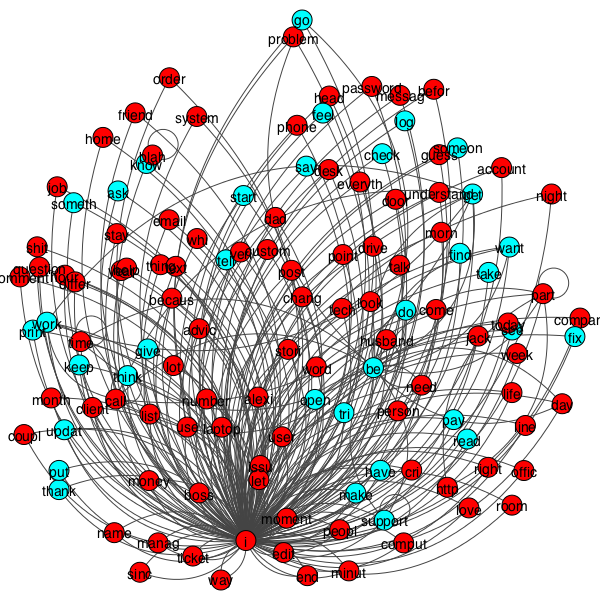

In [102]:
IPython.display.Image('data/gNV_I.png')

Instead of just those connect to a vertex we can find all those connected to it within 2 hops, lets look at 'stori' for this

In [103]:
gNV.vs.find('stori')

igraph.Vertex(<igraph.Graph object at 0x116f6c138>, 2818, {'color': (1.0, 0.0, 0.0, 1.0), 'kind': 'NN', 'label': 'stori', 'name': 'stori'})

In [104]:
storyNeighbors = gNV.neighbors('stori')
storyNeighborsPlus1 = set(storyNeighbors)
for n in storyNeighbors:
    storyNeighborsPlus1 |= set(gNV.neighbors(n))

In [105]:
gNV_story = gNV.subgraph(gNV.vs.select(storyNeighborsPlus1))
gNV_story.vcount()

2585

A large network, but we can compute some statistics:

In [106]:
sorted(zip(gNV_story.vs['name'], gNV_story.degree()), key = lambda x: x[1], reverse = True)[:10]

[('i', 3566),
 ('be', 1600),
 ('get', 1190),
 ('time', 1022),
 ('call', 960),
 ('do', 952),
 ('have', 944),
 ('work', 932),
 ('go', 842),
 ('day', 806)]

Or by eignvector centrality:

In [107]:
sorted(zip(gNV_story.vs['name'], gNV_story.eigenvector_centrality()), key = lambda x: x[1], reverse = True)[:10]

[('i', 1.0),
 ('be', 0.7109047446588141),
 ('get', 0.610054312010614),
 ('time', 0.5491663237665918),
 ('call', 0.5458456827239075),
 ('do', 0.5455016616302165),
 ('have', 0.5351490340248723),
 ('work', 0.5103731805283773),
 ('go', 0.4728176569248663),
 ('day', 0.4718355186133639)]

Notice that 'stori' isn't even in the top 10:

Lets filter it a bit than plot

In [108]:
gNV_story = gNV_story.subgraph(gNV_story.vs.select(lambda x: x.degree() > 5 or x['name'] == 'stori'))
gNV_story = gNV_story.subgraph_edges(gNV_story.es.select(lambda x: x['weight'] > 10))
gNV_story.vs.find('stori')['color'] = 'yellow'

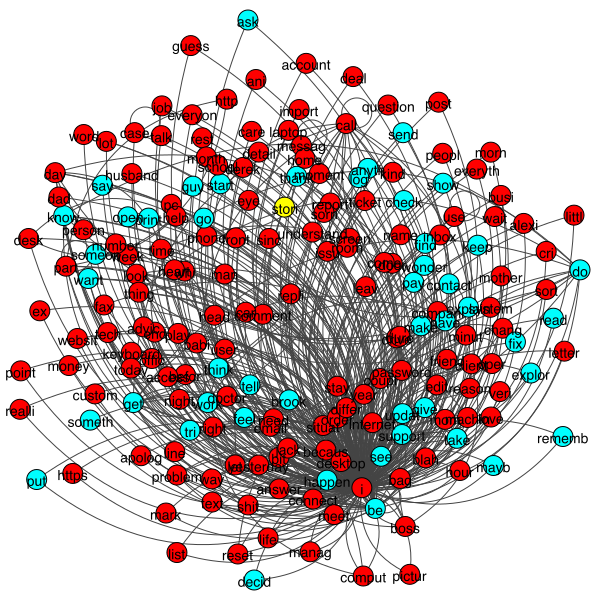

In [109]:
layoutNV_story = gNV_story.layout_fruchterman_reingold(repulserad = .001)
ig.plot(gNV_story, layout = layoutNV_story, target = 'data/gNV_story.png')

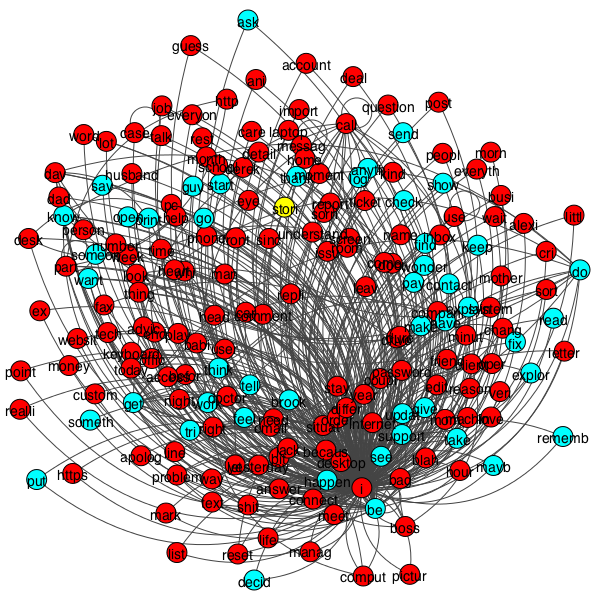

In [110]:
IPython.display.Image('data/gNV_story.png')

I is still in the middle

## <span style="color:red">*Your Turn*</span>

<span style="color:red">Construct cells immediately below this that construct at least two different networks comprising different combinations of word types, linked by different syntactic structures, that illuminate your corpus and the dynamics you are interested to explore. Graph these networks or subnetworks within them. What are relationships that are meaningful?